Copyright 2020 DeepMind Technologies Limited.

Licensed under the Apache License, Version 2.0 (the "License");
you may not use this file except in compliance with the License.
You may obtain a copy of the License at

https://www.apache.org/licenses/LICENSE-2.0

Unless required by applicable law or agreed to in writing, software
distributed under the License is distributed on an "AS IS" BASIS,
WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
See the License for the specific language governing permissions and
limitations under the License.

<p align="center">
  <h1 align="center">TAPIR: Tracking Any Point with per-frame Initialization and temporal Refinement</h1>
  <p align="center">
    <a href="http://www.carldoersch.com/">Carl Doersch</a>
    ·
    <a href="https://yangyi02.github.io/">Yi Yang</a>
    ·
    <a href="https://scholar.google.com/citations?user=Jvi_XPAAAAAJ">Mel Vecerik</a>
    ·
    <a href="https://scholar.google.com/citations?user=cnbENAEAAAAJ">Dilara Gokay</a>
    ·
    <a href="https://www.robots.ox.ac.uk/~ankush/">Ankush Gupta</a>
    ·
    <a href="http://people.csail.mit.edu/yusuf/">Yusuf Aytar</a>
    ·
    <a href="https://scholar.google.co.uk/citations?user=IUZ-7_cAAAAJ">Joao Carreira</a>
    ·
    <a href="https://www.robots.ox.ac.uk/~az/">Andrew Zisserman</a>
  </p>
  <h3 align="center"><a href="https://arxiv.org/abs/2306.08637">Paper</a> | <a href="https://deepmind-tapir.github.io">Project Page</a> | <a href="https://github.com/deepmind/tapnet">GitHub</a> | <a href="https://github.com/deepmind/tapnet/tree/main#running-tapir-locally">Live Demo</a> </h3>
  <div align="center"></div>
</p>

<p align="center">
  <a href="">
    <img src="https://storage.googleapis.com/dm-tapnet/swaying_gif.gif" alt="Logo" width="50%">
  </a>
</p>

In [1]:
# @title Download Code {form-width: "25%"}
!git clone https://github.com/deepmind/tapnet.git

Cloning into 'tapnet'...
remote: Enumerating objects: 618, done.
remote: Counting objects: 100% (291/291), done.
remote: Compressing objects: 100% (132/132), done.
remote: Total 618 (delta 175), reused 208 (delta 159), pack-reused 327
Receiving objects: 100% (618/618), 1.28 MiB | 4.24 MiB/s, done.
Resolving deltas: 100% (365/365), done.


In [2]:
# @title Install Dependencies {form-width: "25%"}
!pip install -r tapnet/requirements_inference.txt

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 371.0/371.0 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.6/511.6 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 9.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 12.9 MB/s eta 0:00:00
  Created wheel for jaxline: filename=jaxline-0.0.8-py3-none-any.whl size=37760 sha256=467c65836f53e91c52bae64612c323567afb56be4faed9b7b2c96374e27a6d1e
  Stored in directory: /root/.cache/pip/wheels/19/d6/75/04b2a65170bebc8e51d3aceb16d526339fd5ac5eed7ef75469
  Created wheel for ml_collections: filename=ml_collections-0.1.1-py3-none-any.whl size=94505 sha256=5338e8b3015add55af79e261f97d73c2c5c5d68ca24ddb4b83fc30dbab0f13e2
  Stored in directory: /root/.cache/pip/wheels/7b/89/c9/a9b87790789e94aadcfc393c283e3ecd5ab916aed0a31be8fe
Successfully built jaxline ml_collections


In [3]:
# @title Download Model {form-width: "25%"}

%mkdir tapnet/checkpoints

!wget -P tapnet/checkpoints https://storage.googleapis.com/dm-tapnet/causal_tapir_checkpoint.npy

%ls tapnet/checkpoints

--2024-01-05 19:57:26--  https://storage.googleapis.com/dm-tapnet/causal_tapir_checkpoint.npy
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.2.207, 142.250.141.207, 2607:f8b0:4023:c06::cf, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.2.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 127043639 (121M) [application/octet-stream]
Saving to: ‘tapnet/checkpoints/causal_tapir_checkpoint.npy’

causal_tapir_checkp 100%[===================>] 121.16M   113MB/s    in 1.1s    

2024-01-05 19:57:27 (113 MB/s) - ‘tapnet/checkpoints/causal_tapir_checkpoint.npy’ saved [127043639/127043639]

causal_tapir_checkpoint.npy


In [4]:
# @title Imports {form-width: "25%"}
%matplotlib widget
import functools

import haiku as hk
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import mediapy as media
import numpy as np
from tqdm import tqdm
import tree

from tapnet import tapir_model
from tapnet.utils import transforms
from tapnet.utils import viz_utils

from google.colab import output
output.enable_custom_widget_manager()

In [5]:
# @title Load Checkpoint {form-width: "25%"}

checkpoint_path = 'tapnet/checkpoints/causal_tapir_checkpoint.npy'
ckpt_state = np.load(checkpoint_path, allow_pickle=True).item()
params, state = ckpt_state['params'], ckpt_state['state']

In [6]:
# @title Build Model {form-width: "25%"}

# Internally, the tapir model has three stages of processing: computing
# image features (get_feature_grids), extracting features for each query point
# (get_query_features), and estimating trajectories given query features and
# the feature grids where we want to track (estimate_trajectories).  For
# tracking online, we need extract query features on the first frame only, and
# then call estimate_trajectories on one frame at a time.

def build_online_model_init(frames, query_points):
  """Initialize query features for the query points."""
  model = tapir_model.TAPIR(use_causal_conv=True, bilinear_interp_with_depthwise_conv=False)

  feature_grids = model.get_feature_grids(frames, is_training=False)
  query_features = model.get_query_features(
      frames,
      is_training=False,
      query_points=query_points,
      feature_grids=feature_grids,
  )
  return query_features


def build_online_model_predict(frames, query_features, causal_context):
  """Compute point tracks and occlusions given frames and query points."""
  model = tapir_model.TAPIR(use_causal_conv=True, bilinear_interp_with_depthwise_conv=False)
  feature_grids = model.get_feature_grids(frames, is_training=False)
  trajectories = model.estimate_trajectories(
      frames.shape[-3:-1],
      is_training=False,
      feature_grids=feature_grids,
      query_features=query_features,
      query_points_in_video=None,
      query_chunk_size=64,
      causal_context=causal_context,
      get_causal_context=True,
  )
  causal_context = trajectories['causal_context']
  del trajectories['causal_context']
  return {k: v[-1] for k, v in trajectories.items()}, causal_context


online_init = hk.transform_with_state(build_online_model_init)
online_init_apply = jax.jit(online_init.apply)

online_predict = hk.transform_with_state(build_online_model_predict)
online_predict_apply = jax.jit(online_predict.apply)

rng = jax.random.PRNGKey(42)
online_init_apply = functools.partial(
    online_init_apply, params=params, state=state, rng=rng
)
online_predict_apply = functools.partial(
    online_predict_apply, params=params, state=state, rng=rng
)

In [7]:
# @title Utility Functions {form-width: "25%"}

def preprocess_frames(frames):
  """Preprocess frames to model inputs.

  Args:
    frames: [num_frames, height, width, 3], [0, 255], np.uint8

  Returns:
    frames: [num_frames, height, width, 3], [-1, 1], np.float32
  """
  frames = frames.astype(np.float32)
  frames = frames / 255 * 2 - 1
  return frames


def postprocess_occlusions(occlusions, expected_dist):
  """Postprocess occlusions to boolean visible flag.

  Args:
    occlusions: [num_points, num_frames], [-inf, inf], np.float32

  Returns:
    visibles: [num_points, num_frames], bool
  """
  pred_occ = jax.nn.sigmoid(occlusions)
  pred_occ = 1 - (1 - pred_occ) * (1 - jax.nn.sigmoid(expected_dist))
  visibles = pred_occ < 0.5  # threshold
  return visibles


def sample_random_points(frame_max_idx, height, width, num_points):
  """Sample random points with (time, height, width) order."""
  y = np.random.randint(0, height, (num_points, 1))
  x = np.random.randint(0, width, (num_points, 1))
  t = np.random.randint(0, frame_max_idx + 1, (num_points, 1))
  points = np.concatenate((t, y, x), axis=-1).astype(np.int32)  # [num_points, 3]
  return points


def construct_initial_causal_state(num_points, num_resolutions):
  value_shapes = {
      "tapir/~/pips_mlp_mixer/block_1_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_1_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_2_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_2_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_3_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_3_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_4_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_4_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_5_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_5_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_6_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_6_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_7_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_7_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_8_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_8_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_9_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_9_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_10_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_10_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_11_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_11_causal_2": (1, num_points, 2, 2048),
      "tapir/~/pips_mlp_mixer/block_causal_1": (1, num_points, 2, 512),
      "tapir/~/pips_mlp_mixer/block_causal_2": (1, num_points, 2, 2048),
  }
  fake_ret = {
      k: jnp.zeros(v, dtype=jnp.float32) for k, v in value_shapes.items()
  }
  return [fake_ret] * num_resolutions * 4

In [8]:
from google.colab import files

uploaded = files.upload()

Saving trackerps.mp4 to trackerps.mp4


In [10]:


video = media.read_video('trackerps.mp4')
height, width = video.shape[1:3]
media.show_video(video, fps=10)

In [ ]:
# @title Progressively Predict Sparse Point Tracks {form-width: "25%"}

resize_height = 256  # @param {type: "integer"}
resize_width = 256  # @param {type: "integer"}
num_points = 20  # @param {type: "integer"}

frames = media.resize_video(video, (resize_height, resize_width))
query_points = sample_random_points(0, frames.shape[1], frames.shape[2], num_points)

query_features, _ = online_init_apply(frames=preprocess_frames(frames[None, None, 0]), query_points=query_points[None])
causal_state = construct_initial_causal_state(query_points.shape[0], len(query_features.resolutions) - 1)

# Predict point tracks frame by frame
predictions = []
for i in range(frames.shape[0]):
  (prediction, causal_state), _ = online_predict_apply(
      frames=preprocess_frames(frames[None, None, i]),
      query_features=query_features,
      causal_context=causal_state,
  )
  predictions.append(prediction)

tracks = np.concatenate([x['tracks'][0] for x in predictions], axis=1)
occlusions = np.concatenate([x['occlusion'][0] for x in predictions], axis=1)
expected_dist = np.concatenate([x['expected_dist'][0] for x in predictions], axis=1)

visibles = postprocess_occlusions(occlusions, expected_dist)

# Visualize sparse point tracks
tracks = transforms.convert_grid_coordinates(tracks, (resize_width, resize_height), (width, height))
video_viz = viz_utils.paint_point_track(video, tracks, visibles)
media.show_video(video_viz, fps=10)

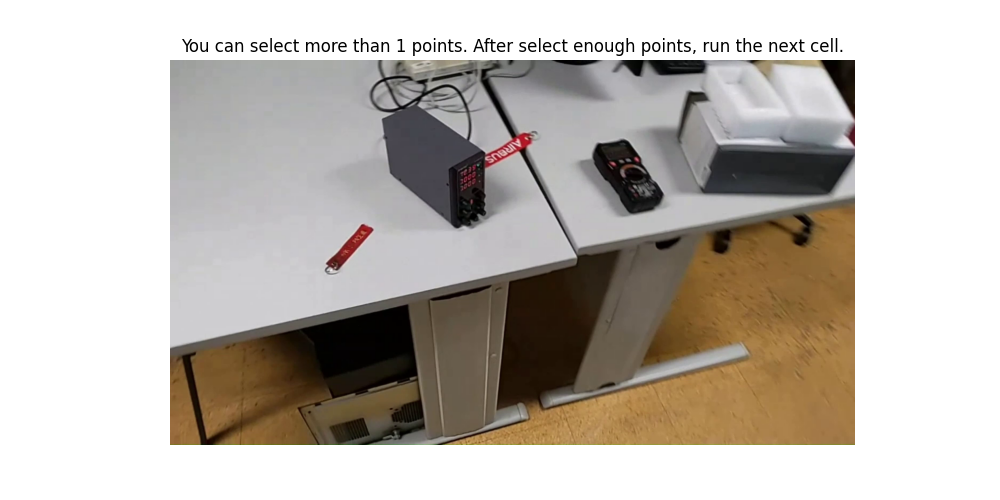

In [51]:
# @title Select Any Points at First Frame {form-width: "25%"}

# Generate a colormap with 20 points, no need to change unless select more than 20 points
colormap = viz_utils.get_colors(20)

fig, ax = plt.subplots(figsize=(10, 5))
ax.imshow(video[0])
ax.axis('off')
ax.set_title('You can select more than 1 points. After select enough points, run the next cell.')

select_points = []

 # Event handler for mouse clicks
def on_click(event):
  if event.button == 1 and event.inaxes == ax:  # Left mouse button clicked
    x, y = int(np.round(event.xdata)), int(np.round(event.ydata))

    select_points.append(np.array([x, y]))

    color = colormap[len(select_points) - 1]
    color = tuple(np.array(color) / 255.0)
    ax.plot(x, y, 'o', color=color, markersize=5)
    plt.draw()

fig.canvas.mpl_connect('button_press_event', on_click)
plt.show()

In [52]:
# @title Predict Point Tracks for the Selected Points {form-width: "25%"}

resize_height = 256  # @param {type: "integer"}
resize_width = 256  # @param {type: "integer"}

def convert_select_points_to_query_points(frame, points):
  """Convert select points to query points.

  Args:
    points: [num_points, 2], [t, y, x]
  Returns:
    query_points: [num_points, 3], [t, y, x]
  """
  points = np.stack(points)
  query_points = np.zeros(shape=(points.shape[0], 3), dtype=np.float32)
  query_points[:, 0] = frame
  query_points[:, 1] = points[:, 1]
  query_points[:, 2] = points[:, 0]
  return query_points

frames = media.resize_video(video, (resize_height, resize_width))
query_points = convert_select_points_to_query_points(0, select_points)
query_points = transforms.convert_grid_coordinates(
    query_points, (1, height, width), (1, resize_height, resize_width), coordinate_format='tyx')

query_features, _ = online_init_apply(frames=preprocess_frames(frames[None, None, 0]), query_points=query_points[None])
causal_state = construct_initial_causal_state(query_points.shape[0], len(query_features.resolutions) - 1)



That's it!

In [53]:
# Visualize query_points
for point in query_points:
    print(f"Query Point: {point}")

Query Point: [  0.          55.82222222 128.8       ]
Query Point: [  0.          61.51111111 122.4       ]
Query Point: [  0.         116.26666667  70.4       ]
Query Point: [  0.         134.75555556  61.6       ]
Query Point: [  0.          65.06666667 174.        ]
Query Point: [  0.          66.84444444 165.2       ]
Query Point: [  0.          69.68888889 170.8       ]
Query Point: [  0.          76.44444444 111.2       ]


In [54]:
# Predict point tracks frame by frame
predictions = []
for i in range(frames.shape[0]):
  (prediction, causal_state), _ = online_predict_apply(
      frames=preprocess_frames(frames[None, None, i]),
      query_features=query_features,
      causal_context=causal_state,
  )
  predictions.append(prediction)

tracks = np.concatenate([x['tracks'][0] for x in predictions], axis=1)
occlusions = np.concatenate([x['occlusion'][0] for x in predictions], axis=1)  #Creates a array with some values to validate with the point is occludet or not
expected_dist = np.concatenate([x['expected_dist'][0] for x in predictions], axis=1) #Creates a array with true or false to show the point

visibles = postprocess_occlusions(occlusions, expected_dist)


########### SHOW RESULTS ##########                                 (FINAL OF THE BLACK BOX)

# Normalize points between 0 to 1
normalized_points = tracks / np.array([[resize_width, resize_height]])
print("Normalized Points:")
for frame_idx in range(len(normalized_points)):
    points_in_frame = normalized_points[frame_idx]
    print(f"Point {frame_idx+1} - Location: {points_in_frame}")



################## Show the video ##################

# Visualize sparse point tracks *before te track2 was just track, but I changed just to the track varible keep the numbers with the same size
tracks2 = transforms.convert_grid_coordinates(tracks, (resize_width, resize_height), (width, height))
video_viz = viz_utils.paint_point_track(video, tracks2, visibles)
media.show_video(video_viz, fps=10)

Normalized Points:
Point 1 - Location: [[0.50499558 0.21962371]
 [0.50525367 0.21985796]
 [0.51127887 0.22208445]
 [0.51681769 0.22797251]
 [0.52802867 0.23590122]
 [0.53759754 0.24788812]
 [0.54952568 0.25784686]
 [0.54934657 0.25756267]
 [0.55873269 0.26381916]
 [0.55966669 0.26592985]
 [0.55320072 0.26303354]
 [0.54252225 0.25803697]
 [0.53456688 0.25544676]
 [0.5345068  0.25553972]
 [0.53186446 0.25536409]
 [0.53162432 0.25780213]
 [0.53118074 0.26356909]
 [0.53083801 0.26890808]
 [0.53112465 0.27150771]
 [0.53102064 0.27133888]
 [0.53034681 0.26874867]
 [0.53063375 0.26423788]
 [0.53360993 0.26032963]
 [0.54008526 0.25972503]
 [0.54832053 0.26118508]
 [0.54815269 0.26129475]
 [0.55780631 0.26614144]
 [0.56744468 0.27160928]
 [0.57616019 0.27735922]
 [0.581379   0.2829375 ]
 [0.58499008 0.28828102]
 [0.58567184 0.28799528]
 [0.58941877 0.29197031]
 [0.59127748 0.2930263 ]
 [0.59106106 0.28964463]
 [0.58532655 0.28709358]
 [0.57787281 0.28751791]
 [0.57773608 0.28757039]
 [0.5691321

In [55]:
# @title Donwload a Video

import imageio

# Defina a localização do arquivo de saída
output_path = 'output_video.mp4'

# Salve o vídeo usando imageio
# Certifique-se de 'video_viz' ser um array numpy válido representando o vídeo
imageio.mimsave(output_path, video_viz)

# Baixe o vídeo
files.download(output_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [16]:
# @title SOTA - Calculate the Center of Mass Point PT

# Supondo que tracks seja a matriz de pontos trackeados e visibles seja a matriz de visibilidade
# e width, height sejam as dimensões da tela utilizada

# Calculando o centro de massa para cada frame
centros_de_massa = []
for frame_idx in range(tracks.shape[1]):  # Loop pelos frames
    pontos_frame = tracks[:, frame_idx, :]  # Todos os pontos no frame atual
    visibilidade_frame = visibles[:, frame_idx]  # Informação de visibilidade para o frame atual

    # Considerar apenas os pontos visíveis no cálculo do centro de massa
    pontos_visiveis = pontos_frame[visibilidade_frame]

    # Verificar se há pontos visíveis neste frame
    if len(pontos_visiveis) > 0:
        centro_de_massa_frame = np.mean(pontos_visiveis, axis=0)  # Calculando o centro de massa

        # Normalizando para as dimensões da tela utilizada
        centro_de_massa_frame_normalized = centro_de_massa_frame / np.array([resize_width, resize_height])
        centros_de_massa.append(centro_de_massa_frame_normalized)
    else:
        # Se nenhum ponto for visível, o centro de massa será [0, 0] normalizado
        centros_de_massa.append([0, 0])

centros_de_massa = np.array(centros_de_massa)
print("Centros de Massa normalizados para cada frame:")
print(centros_de_massa)

Centros de Massa normalizados para cada frame:
[[0.41175368 0.25984713]
 [0.41269046 0.25923687]
 [0.41443759 0.26106662]
 [0.41861051 0.26552123]
 [0.42503259 0.27035847]
 [0.43261668 0.27945817]
 [0.44141015 0.28793761]
 [0.44147658 0.28801823]
 [0.44573069 0.29321674]
 [0.44419622 0.29358047]
 [0.43353069 0.28886232]
 [0.41751516 0.28115493]
 [0.40599078 0.2737498 ]
 [0.4058907  0.27348867]
 [0.40183619 0.27003235]
 [0.3986243  0.27243483]
 [0.39634457 0.27742368]
 [0.39450687 0.28184289]
 [0.3921631  0.28301272]
 [0.39175826 0.28262684]
 [0.38985288 0.27884483]
 [0.38849905 0.2742714 ]
 [0.38908875 0.26640052]
 [0.39291301 0.26464477]
 [0.3998152  0.26204184]
 [0.39952731 0.26157922]
 [0.40760276 0.26360971]
 [0.41708165 0.2649847 ]
 [0.42424786 0.26718664]
 [0.43014777 0.2664296 ]
 [0.43342838 0.26669055]
 [0.43325961 0.26675528]
 [0.4350515  0.26440495]
 [0.43632504 0.25976574]
 [0.43362933 0.25527698]
 [0.42882273 0.24877736]
 [0.42021221 0.24646132]
 [0.42045188 0.24642374]
 [0

In [46]:
# @title SOTA - Create Bounding Box YoloV7 PT

# Supondo que 'centros_de_massa' seja a matriz de centros de massa normalizados
# Supondo também que 'tracks' contenha as coordenadas dos pontos trackeados
# e 'width', 'height' sejam as dimensões da tela utilizada

box_size=1.2

# Função para calcular a distância entre dois pontos
def calcular_distancia(ponto1, ponto2):
    return np.sqrt(np.sum((ponto1 - ponto2) ** 2))

# Calculando a bounding box para cada frame
bounding_boxes = []
for frame_idx in range(centros_de_massa.shape[0]):  # Loop pelos frames
    centro_massa_frame = centros_de_massa[frame_idx]  # Centro de massa para o frame atual
    pontos_frame = tracks[:, frame_idx, :]  # Todos os pontos no frame atual

    # Calculando a distância máxima do centro de massa aos pontos
    distancias = [calcular_distancia(centro_massa_frame, ponto) for ponto in pontos_frame]
    ponto_distante_idx = np.argmax(distancias)  # Índice do ponto mais distante
    ponto_distante = pontos_frame[ponto_distante_idx]  # Ponto mais distante

    # Calculando a largura e altura da bounding box
    largura = (abs(centro_massa_frame[0] - ponto_distante[0]))/(box_size*1.7)
    altura = (abs(centro_massa_frame[1] - ponto_distante[1]))/box_size

    # Calculando as coordenadas x, y, largura e altura para YOLOv7
    x = centro_massa_frame[0]
    y = centro_massa_frame[1]

    # Normalizando os valores entre 0 e 1

    largura /= resize_width
    altura /= resize_height

    bounding_boxes.append([x, y, largura, altura])

bounding_boxes = np.array(bounding_boxes)
print("Bounding Boxes in YOLOv7 Format for each frame:")
#print(bounding_boxes)

Bounding Boxes in YOLOv7 Format for each frame:


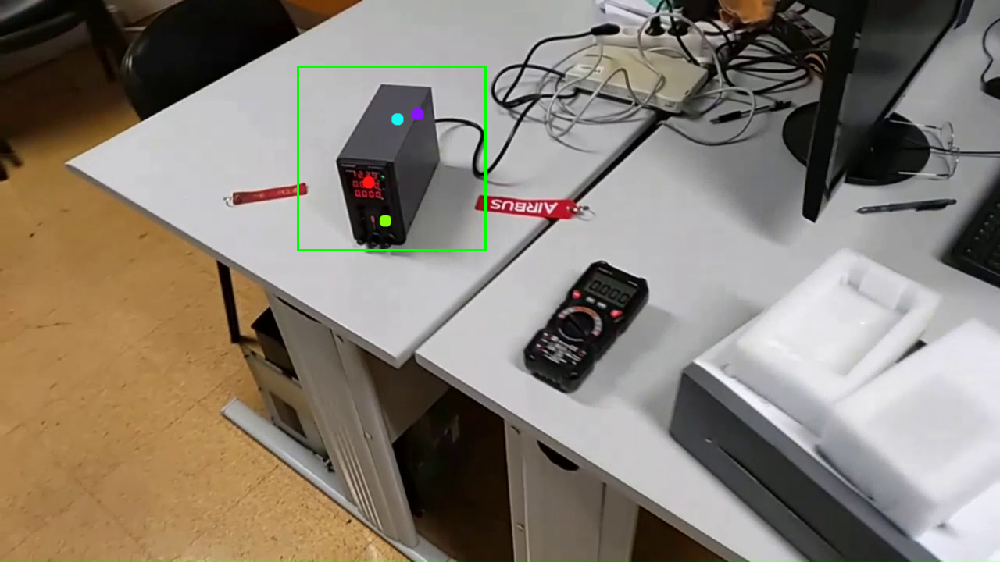

In [47]:
# @title SOTA - Visualize the bounding boxes PT

from google.colab.patches import cv2_imshow
import cv2
import numpy as np

frame_index = 70  # Índice do frame desejado

# Obter o frame específico do vídeo
frame = np.array(video_viz[frame_index])

# Obter as dimensões do frame
altura, largura = frame.shape[:2]

# Obter as coordenadas da bounding box para o frame desejado
x, y, largura_bbox, altura_bbox = bounding_boxes[frame_index]

# Calcular os pontos da bounding box
x1 = int((x - largura_bbox / 2) * largura)
y1 = int((y - altura_bbox / 2) * altura)
x2 = int((x + largura_bbox / 2) * largura)
y2 = int((y + altura_bbox / 2) * altura)

# Desenhar a bounding box sobre o frame
frame_com_bbox = cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Cor verde, espessura 2

# Converter a imagem de BGR para RGB
frame_rgb = cv2.cvtColor(frame_com_bbox, cv2.COLOR_BGR2RGB)

# Mostrar o frame com a bounding box
cv2_imshow(frame_rgb)

In [48]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

# Crie uma lista vazia para armazenar os frames
frames = []

# Vamos supor que você já tenha 'video_viz' e 'bounding_boxes' definidos anteriormente

# Para cada um dos 57 frames
for frame_index in range(80):
    # Obter o frame específico do vídeo
    frame = np.array(video_viz[frame_index])

    # Obter as dimensões do frame
    altura, largura = frame.shape[:2]

    # Obter as coordenadas da bounding box para o frame desejado
    x, y, largura_bbox, altura_bbox = bounding_boxes[frame_index]

    # Calcular os pontos da bounding box
    x1 = int((x - largura_bbox / 2) * largura)
    y1 = int((y - altura_bbox / 2) * altura)
    x2 = int((x + largura_bbox / 2) * largura)
    y2 = int((y + altura_bbox / 2) * altura)

    # Desenhar a bounding box sobre o frame
    frame_com_bbox = cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Cor azul, espessura 2 (invertendo para BGR)

    # Adicione o frame com a bounding box à lista de frames
    frames.append(frame_com_bbox)

# Dimensões do vídeo e o formato
altura, largura, _ = frames[0].shape
fps = 8  # Frames por segundo
tempo_por_frame = 1 / fps

# Defina o nome e o formato do arquivo de saída (por exemplo, 'video_saida.mp4')
nome_arquivo_saida = 'video_saida2.mp4'

# Crie um objeto VideoWriter usando o codec de vídeo desejado
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Escolha o codec apropriado
out = cv2.VideoWriter(nome_arquivo_saida, fourcc, fps, (largura, altura))

# Adicione cada frame ao vídeo
for frame in frames:
    # Inverte a ordem dos canais de cores para BGR (OpenCV usa BGR ao invés de RGB)
    frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
    out.write(frame_bgr)  # Escreve o frame no vídeo

# Libere o objeto VideoWriter e feche o arquivo de vídeo
out.release()

In [20]:
ls

sample_data/  tapnet/  trackerps.mp4  video_saida2.mp4


In [49]:
from google.colab import files

# Replace 'video_saida.mp4' with the name of your video file
files.download('video_saida2.mp4')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>